In [1]:
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import animation
from IPython.display import HTML
from skimage import io

In [2]:
def make_movie(hs):
    N = len(hs)
    T = hs[0].shape[0]
    mins = list(map(np.amin, hs))
    maxes = list(map(np.amax, hs))
    fig, ax = plt.subplots(1, N, figsize=(6*N, 6))
    panels = []         
    for n in range(N): 
        if N == 1: 
            p = ax.imshow(hs[0][0], cmap='plasma')
            fig.colorbar(p, shrink=0.7)
        else: 
            p = ax[n].imshow(hs[n][0], vmin=mins[n], vmax=maxes[n], cmap='plasma')
            fig.colorbar(p, ax=ax[n], shrink=0.7)
        panels.append(p)
    
    def animate(i): 
        for n in range(N):
            panels[n].set_data(hs[n][i])
        return panels

    ani = animation.FuncAnimation(fig, animate, interval=50, blit=True,
                                    repeat_delay=1000, frames=T)
    plt.close() 
    return ani 


def cross_correlation(h, actinxy): 
    T = h.shape[0] 
    taus = np.arange(-T+1, T-1).astype('int')
    cross_corr = [] 
    for tau in taus:
        if tau < 0: 
            cross_corr.append(np.mean(h[-tau:]*actinxy[:tau], axis=0))
        elif tau > 0: 
            cross_corr.append(np.mean(h[:-tau]*actinxy[tau:], axis=0))
        else: 
            cross_corr.append(np.mean(h*actinxy, axis=0))
    return taus, np.array(cross_corr)

def radial_average(Sk): 
    L = Sk.shape[0]
    k = np.fft.fftshift(np.fft.fftfreq(L))
    kx, ky = np.meshgrid(k, k)
    kr = np.sqrt(kx**2 + ky**2)

    f = lambda r : Sk[(kr >= r-.5/L) & (kr < r+.5/L)].mean()
    Sr = np.vectorize(f)(np.linspace(0, 0.5, 100))
    return Sr, np.linspace(0, 0.5, 100)

## Load the membrane height data and actin density data

In [3]:
filename = 'Xin data/membrane-actin/XIN221012_Stellaris_CAAX_Lifeact_e1_cortex_f21-56_caax_height-map.npy'
h = np.load(filename)

filename = 'Xin data/membrane-actin/raw_data/XIN221012_Stellaris_CAAX_Lifeact_e1_cortex_f21-56_lifeact.tif'
actin = io.imread(filename)
print(actin.shape)

filename = 'Xin data/membrane-actin/raw_data/XIN221012_Stellaris_CAAX_Lifeact_e1_cortex_f21-56_caax.tif'
membrane = io.imread(filename)
print(membrane.shape)

actinxy = np.max(actin, axis=1)

(36, 20, 480, 480)
(36, 20, 480, 480)


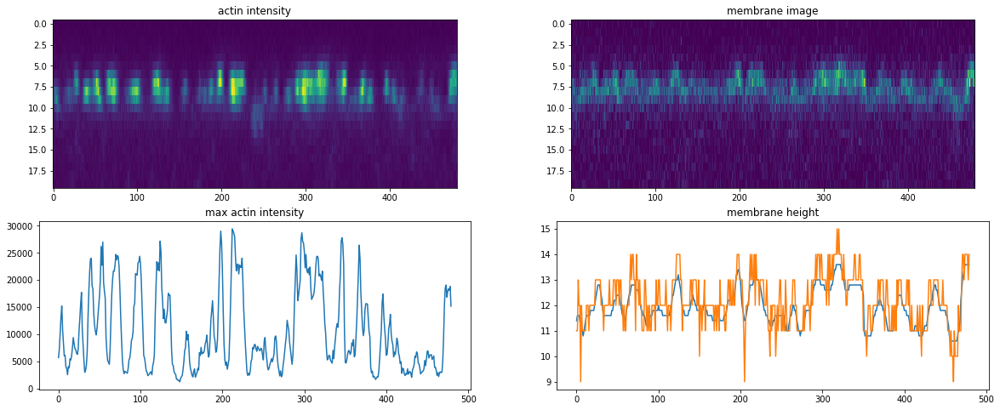

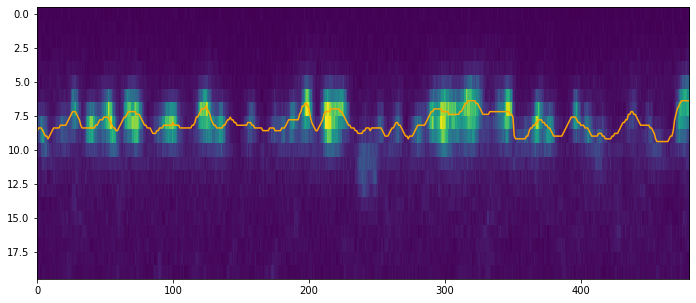

In [4]:
fig, ax = plt.subplots(2, 2, figsize=(20, 8))
ax[0, 0].imshow(actin[0, :, 240], interpolation='none', aspect=10)
ax[0, 0].set_title('actin intensity')
ax[1, 0].plot(actinxy[0, 240])
ax[1, 0].set_title('max actin intensity')
ax[0, 1].imshow(membrane[0, :, 240], interpolation='none', aspect=10)
ax[0, 1].set_title('membrane image')
ax[1, 1].plot(h[0, 240])
ax[1, 1].plot(20-np.argmax(membrane, axis=1)[0, 240])
ax[1, 1].set_title('membrane height')
plt.show() 

plt.figure(figsize=(20, 5))
plt.imshow(actin[0, :, 240], interpolation='none', aspect=10)
plt.plot(20 - h[0, 240], color='orange')
plt.show()

In [5]:
ani = make_movie([h, actinxy])
HTML(ani.to_jshtml())

## Plot temporal average and spatial average 

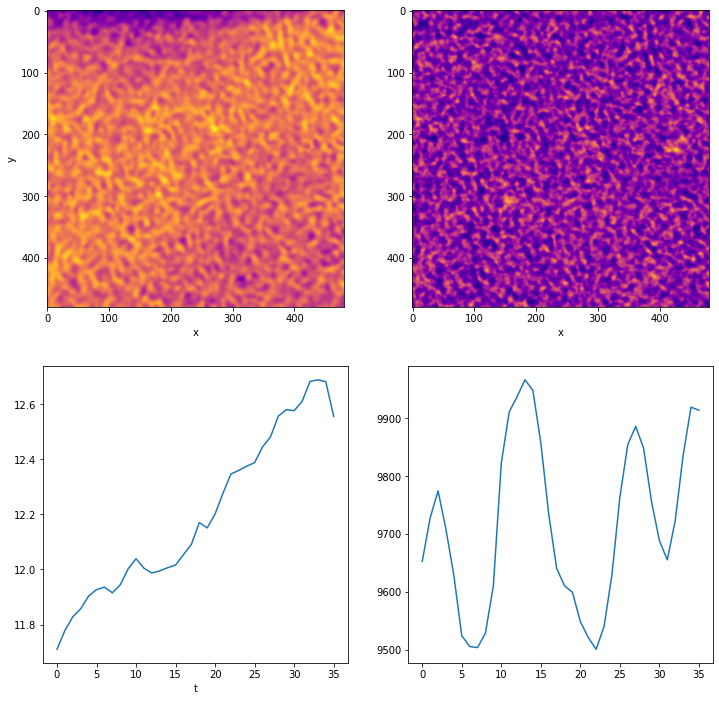

In [7]:
fig, ax = plt.subplots(2, 2, sharex='row', figsize=(12, 12))

ht = np.mean(h, axis=0)
actt = np.mean(actinxy, axis=0)
ax[0, 0].imshow(ht, cmap='plasma')
ax[0, 1].imshow(actt, cmap='plasma')
ax[0, 0].set_xlabel('x')
ax[0, 1].set_xlabel('x')
ax[0, 0].set_ylabel('y')

hx = np.mean(h, axis=(1, 2))
actx = np.mean(actinxy, axis=(1, 2))
ax[1, 0].plot(hx)
ax[1, 1].plot(actx)
ax[1, 0].set_xlabel('t')
plt.show()

#### Comments on temporal average: 
- Both temporal averages show finite length-scale spatial structure 
- The temporal average of the membrane has a trend in the y direction, possibly due to imaging artefacts or curvature of the embroy 

#### Comments on spatial average: 
- The membrane height goes up over time; need more samples to determine whether this is just random noise 
- The actin density seems to oscillate over time 

## After subtracting temporal average (a function of space)

In [8]:
ani = make_movie([h-ht[np.newaxis, :, :], actinxy-actt[np.newaxis, :, :]])
HTML(ani.to_jshtml())

## After subtracting spatial average (a function of space)

In [9]:
ani = make_movie([h-hx[:, np.newaxis, np.newaxis], actinxy-actx[:, np.newaxis, np.newaxis]])
HTML(ani.to_jshtml())

## Look at cross correlation in time for fixed x, y 

We subtract off the average value of h for each frame, otherwise the cross correlation is dominiated by the average

In [66]:
taus, cross_corr = cross_correlation(h-hx[:, np.newaxis, np.newaxis], actinxy)

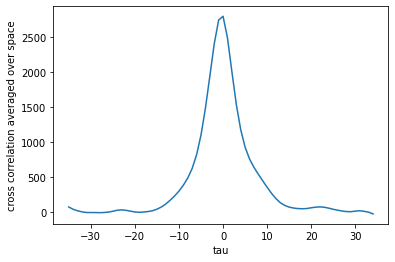

In [67]:
plt.plot(taus, np.mean(cross_corr, axis=(1, 2)))
plt.xlabel('tau')
plt.ylabel('cross correlation averaged over space')
plt.show() 

This shows that there is significant same-time correlation between the two variables

## We can also compute the time correlation using Fourier transform. 

If the domain is periodic/infinite, this would be the same as the previous method. In our case, it depends on whether the Fourier transform identity holds as we sum over different ranges of t. 

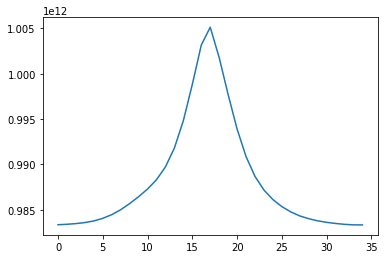

In [74]:
hw = np.fft.fft(h, axis=0)
actinw = np.fft.fft(actinxy, axis=0)

time_corr = np.fft.ifft(hw*np.conjugate(actinw), axis=0)
plt.plot(np.fft.fftshift(np.abs(np.sum(time_corr[1:], axis=(1, 2)))))
plt.show() 

## Compute structure factor and cross correlation in space

In [107]:
hk = np.fft.fftshift(np.fft.fft2(h), axes=(1, 2))
actink = np.fft.fftshift(np.fft.fft2(actinxy), axes=(1, 2))

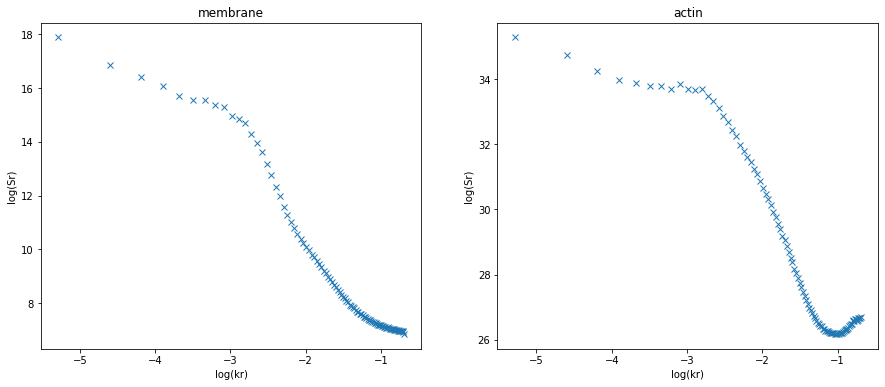

In [112]:
Sh = np.mean(np.abs(hk)**2, axis=0) 
Sactin = np.mean(np.abs(actink)**2, axis=0)
Sh_r, kr = radial_average(Sh)
Sactin_r, _ = radial_average(Sactin)


fig, ax = plt.subplots(1, 2, figsize=(15, 6))

ax[0].plot(np.log(kr[1:]), np.log(Sh_r[1:]), 'x')
ax[0].set_xlabel('log(kr)')
ax[0].set_ylabel('log(Sr)')
ax[0].set_title('membrane')


ax[1].plot(np.log(kr[1:]), np.log(Sactin_r[1:]), 'x')
ax[1].set_xlabel('log(kr)')
ax[1].set_ylabel('log(Sr)')
ax[1].set_title('actin') 

plt.show() 

## Finally, look at the width of the membrane

In [113]:
mean_height = np.mean(h, axis=(1, 2))
wsq = np.mean((h - mean_height[:, np.newaxis, np.newaxis])**2, axis=(1, 2))

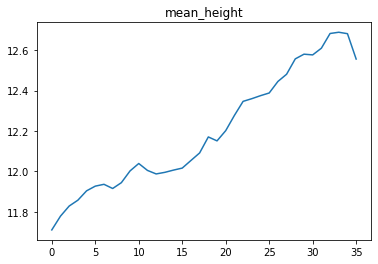

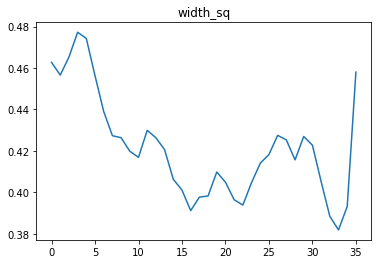

In [114]:
plt.plot(mean_height)
plt.title('mean_height')
plt.show() 

plt.plot(wsq)
plt.title('width_sq')
plt.show() 